In [1]:
%matplotlib inline
import sys
sys.path.insert(0, "../..") # Adds the module to path

# Example 7. Image generation

Trains a conditional GAN to convert masks to cell images using the segmented anisotropic ssTEM dataset.

## 1. Setup

Imports and defines the objects needed for this example.

In [2]:
import os
import sys
import json
import numpy as np
import matplotlib.pyplot as plt
import itertools
import glob
import datasets
from tensorflow.keras import layers

import deeptrack as dt

datasets.load("MitoGAN")
PATH_TO_DATASET = "./datasets/MitoGAN/"

TRAINING_ROOT = PATH_TO_DATASET + 'train/'
VALIDATION_ROOT = PATH_TO_DATASET + 'validation/'

TRAINING_PATHS =  sorted(glob.glob(TRAINING_ROOT + "*"))
VALIDATION_PATHS =  sorted(glob.glob(VALIDATION_ROOT + "*"))

number_of_training_files = len([file for file in TRAINING_PATHS if "membranes_" in file])
number_of_validation_files = len([file for file in VALIDATION_PATHS if "membranes_" in file])

../..\deeptrack\backend\_config.py:11: UserWarning: cupy not installed. GPU-accelerated simulations will not be possible
  warnings.warn(
../..\deeptrack\backend\_config.py:25: UserWarning: cupy not installed, CPU acceleration not enabled
  warnings.warn("cupy not installed, CPU acceleration not enabled")


MitoGAN already downloaded! Use force_overwrite=True to redownload the dataset.


## 2. Defining the dataset

We begin by defining cyclic iterators over the dataset. The files are numbered by integers, so we iterate over the integers.

In [3]:
training_index_iterator = itertools.cycle(iter(range(number_of_training_files)))
validation_index_iterator = itertools.cycle(iter(range(number_of_validation_files)))

We define a base feature that contains the logic that switches between the validation set and the training set. It also stores the current file index.

In [4]:
root = dt.DummyFeature(
    validation=False,
    base_path=lambda validation: VALIDATION_ROOT if validation else TRAINING_ROOT,
    index=lambda validation: next(validation_index_iterator) if validation \
                             else next(training_index_iterator)
)

We define a loader for the raw image, the membranes and the mitochondria. They all inherit the properties of root, which is how we guarantee that they all load the correct index.

In [5]:
load_string_struct = "{0}{1}{2}.png"

load_training_image = root >> dt.LoadImage(
    path = lambda index, base_path: load_string_struct.format(base_path, "raw_", index),
    **root.properties
)


load_training_membranes = root >> dt.LoadImage(
    path = lambda index, base_path: load_string_struct.format(base_path, "membranes_", index),
    **root.properties
) 

load_training_mitochondria = root >> dt.LoadImage(
    path = lambda index, base_path: load_string_struct.format(base_path, "mitochondria_", index),
    **root.properties
)

The training images are normalized between -1 and 1

In [6]:
normalization = dt.NormalizeMinMax(-1, 1)
normalized_training_image = load_training_image >> normalization

We combine the masks of membranes and mitochondria into a single mask.

In [7]:
training_mask_labels = load_training_membranes & load_training_mitochondria
training_mask = training_mask_labels >>  dt.Merge(lambda: lambda image: image[1]*1.0 - image[0])

We divide the masks by 255 to get a result between -1 and 1, and add some noise.

We could clip or normalize the results to ensure they are between -1 and 1, but that would skew the average of the mask as a function of the noise level.

In [8]:
noise = dt.Gaussian(mu=0, sigma=lambda: np.random.rand() * 0.1)
noised_mask = training_mask / 255 >> noise

We combine the images and the masks and add some augmentations. Finally, we conditionally skip the augmentation step if we are currently resolving validation images.

In [9]:
combined = normalized_training_image & noised_mask

augmented_dataset = dt.Reuse(combined, 8)
augmented_dataset >>= dt.FlipLR()
augmented_dataset >>= dt.Affine(
    rotate=lambda: np.random.rand() * 2 * np.pi,
    shear=lambda: np.random.rand() * 0.3 - 0.15,
    scale={
        "x": np.random.rand() * 0.3 + 0.85,
        "y": np.random.rand() * 0.3 + 0.85
    },
    mode="reflect"
)

dataset = dt.ConditionalSetFeature(
    on_true=combined,
    on_false=augmented_dataset,
    condition="is_validation",
    is_validation=root.validation,
)

The image and mask functions just return the results directly

In [10]:
# Load labels from storage
def get_image(image):
    return image[0]

def get_mask(image):
    return image[1]

### 3. Visualizing the training data

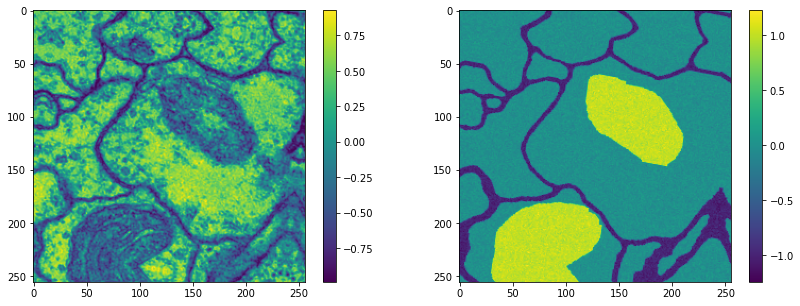

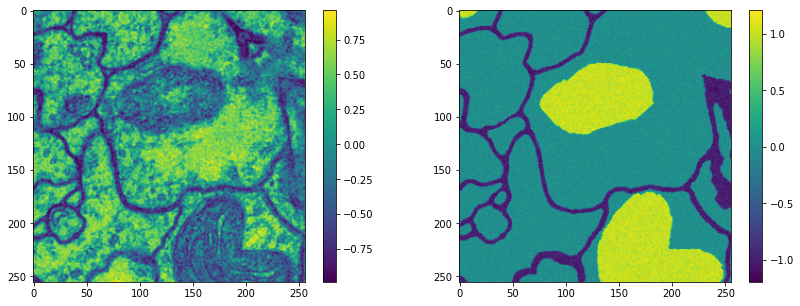

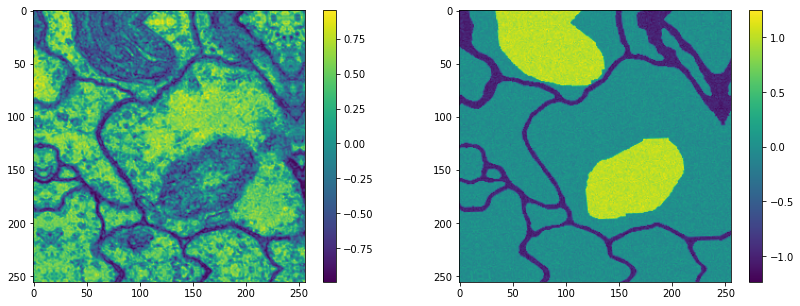

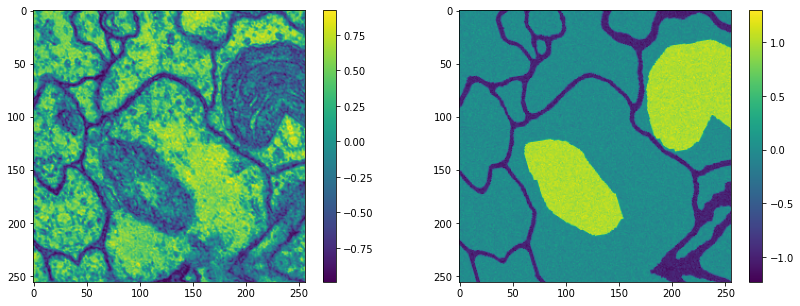

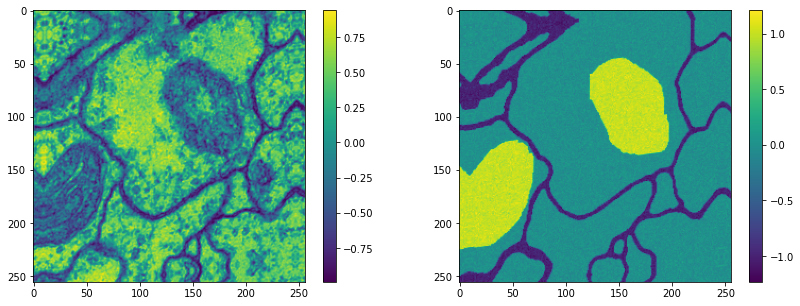

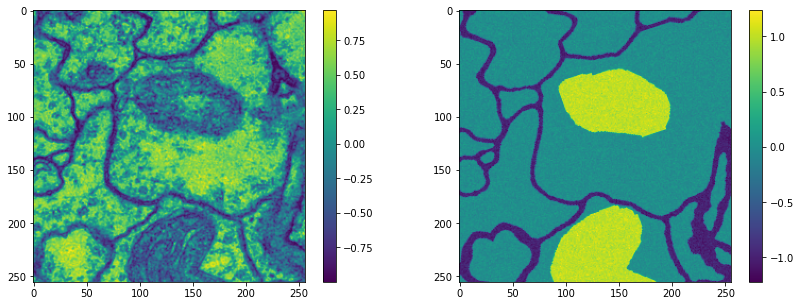

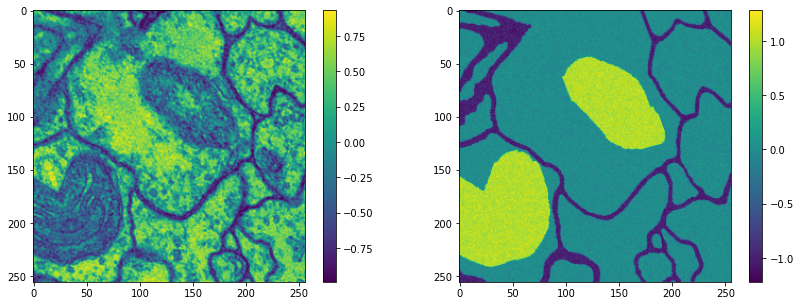

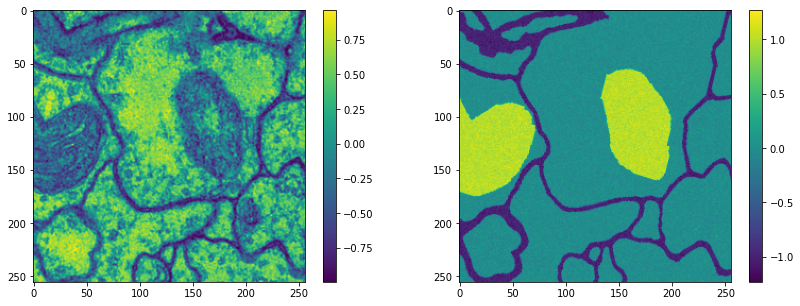

In [11]:
import tensorflow.keras.utils as utils

NUMBER_OF_IMAGES = 8
for image_index in range(NUMBER_OF_IMAGES):
    image_tuple = dataset.update().resolve()
    image = get_image(image_tuple)
    mask = get_mask(image_tuple)
    
    plt.figure(figsize=(14, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.colorbar()
    plt.subplot(1, 2, 2)
    plt.imshow(mask)
    plt.colorbar()
    plt.show()

## 4. Defining the model

We will be defining a conditional GAN. We compose it of two submodels, the generator and the discriminator. 

### 4.1 Defining the generator

We define computation blocks that, unlike the default implementation, use leaky relu activation and instance normalization. Moreover, we use a trainable pooling block, a residual base layer and a biliear upsampling step.

In [12]:
activation = lambda x: layers.LeakyReLU(0.2)(x)

convolution_block = dt.layers.ConvolutionalBlock(
    activation=activation, 
    normalization="InstanceNormalization",
)
base_block = dt.layers.ResidualBlock(
    activation=activation
)
pooling_block = dt.layers.ConvolutionalBlock(
    strides=2, 
    activation=activation, 
    normalization="InstanceNormalization",
)
deconvolution_block = dt.layers.StaticUpsampleBlock(
    kernel_size=3, 
    normalization="InstanceNormalization",
    activation=activation
)

generator = dt.models.unet(
    input_shape = (None, None, 1),                            # shape of the input
    conv_layers_dimensions = (16, 32, 64, 128, 256, 512), # number of features in each convolutional layer
    base_conv_layers_dimensions = (1024,),                  # number of features at the base of the unet
    output_conv_layers_dimensions = (16, 16),               # number of features in convolutional layer after the U-net
    steps_per_pooling = 2, #2                                 # number of convolutional layers per pooling layer
    number_of_outputs = 1,                                  # number of output features
    output_activation = "tanh",                             # activation function on final layer
    compile = False,
    output_kernel_size = 1,
    encoder_convolution_block=convolution_block,
    decoder_convolution_block=convolution_block,
    base_convolution_block=base_block,
    pooling_block=pooling_block,
    upsampling_block=deconvolution_block,
    output_convolution_block=convolution_block
)

generator.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 1 160         input_1[0][0]                    
__________________________________________________________________________________________________
layer (Layer)                   (None, None, None, 1 0           conv2d[0][0]                     
__________________________________________________________________________________________________
instance_normalization (Instanc (None, None, None, 1 32          layer[0][0]                      
______________________________________________________________________________________________

### 4.2 Defining the discriminator

We define computation blocks that, unlike the default implementation, use leaky relu activation.

In [13]:
def discriminator_convolution_block(x):
    if x == 16:
        return dt.layers.ConvolutionalBlock(
            kernel_size=(4, 4), 
            strides=2, 
            activation=activation,
        )(x)
    else:
        return dt.layers.ConvolutionalBlock(
            kernel_size=(4, 4), 
            strides=2, 
            activation=activation,
            normalization="InstanceNormalization",
            norm_kwargs={"axis":-1, "center": False, "scale":False}
        )(x)



discriminator_pooling_block = lambda f: (lambda x: x)

discriminator = dt.models.convolutional(
    input_shape = [(256, 256, 1), (256, 256, 1)],                       # shape of the input  
    conv_layers_dimensions = (16, 32, 64, 128, 256),   # number of features in each convolutional layer
    dense_layers_dimensions = (),                      # number of neurons in each dense layer
    number_of_outputs = 1,                             # number of neurons in the final dense step (numebr of output values)
    compile = False,
    output_kernel_size = 4,
    dense_top=False,
    convolution_block=discriminator_convolution_block,
    pooling_block=discriminator_pooling_block
)

discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
input_3 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
concatenate_6 (Concatenate)     (None, 256, 256, 2)  0           input_2[0][0]                    
                                                                 input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_42 (Conv2D)              (None, 128, 128, 16) 528         concatenate_6[0][0]        

### 4.3 Creating the cGAN

We combine the generator and the discriminator into a cgan, while defining their loss functions.

In [14]:
from tensorflow.keras.optimizers import Adam                                 

# model
model = dt.models.CGAN(generator = generator, 
    discriminator = discriminator,
    discriminator_loss = "mse",
    discriminator_optimizer = Adam(lr = 0.0002, beta_1 = 0.5),
    discriminator_metrics = "accuracy",
    assemble_loss = ["mse","mae"],
    assemble_optimizer = Adam(lr = 0.0002, beta_1 = 0.5),
    assemble_loss_weights = [1, 0.8],
)

C:\Users\GU\.virtualenvs\AutoTrackingPaper-UvNsjtmo\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


## 5. Training the cGAN

We train the network for 1000 epochs, using a continuous generator. (Note that newer versions of tensorflow may not be able to load these weights) 

In [15]:
TRAIN_MODEL = True

if TRAIN_MODEL:
    data_generator = dt.generators.ContinuousGenerator(
        dataset,
        label_function=get_image,
        batch_function=get_mask,
        batch_size = 16,
        min_data_size=512,
        max_data_size=513,
    )

    with data_generator:
        model.fit(
            data_generator, 
            epochs = 1000, 
            steps_per_epoch=16
        )
else:
    path = datasets.load_model("MitoGAN")
    model.load_weights(path)

Generating 513 / 512 samples before starting training
Epoch 1/1000
16/16 [==============================] - 21s 184ms/step - d_loss: 1.1004 - g_loss: 1.7392
Epoch 2/1000
16/16 [==============================] - 3s 211ms/step - d_loss: 0.8178 - g_loss: 0.8721
Epoch 3/1000
16/16 [==============================] - 3s 190ms/step - d_loss: 0.8716 - g_loss: 0.6320
Epoch 4/1000
16/16 [==============================] - 3s 199ms/step - d_loss: 0.8400 - g_loss: 0.6083
Epoch 5/1000
16/16 [==============================] - 3s 191ms/step - d_loss: 0.7128 - g_loss: 0.5291
Epoch 6/1000
16/16 [==============================] - 3s 188ms/step - d_loss: 0.6271 - g_loss: 0.4733
Epoch 7/1000
16/16 [==============================] - 3s 184ms/step - d_loss: 0.5771 - g_loss: 0.4492
Epoch 8/1000
16/16 [==============================] - 3s 192ms/step - d_loss: 0.5455 - g_loss: 0.4514
Epoch 9/1000
16/16 [==============================] - 3s 201ms/step - d_loss: 0.5144 - g_loss: 0.4305
Epoch 10/1000
16/16 [======

KeyboardInterrupt: 

## 6. Validating the results

### 6.1 Prediction visualization

We show 7 images generated by the network.

1.7106012
1.8459332
1.8865434
1.9533304
1.9510344
1.9068577
1.8646941


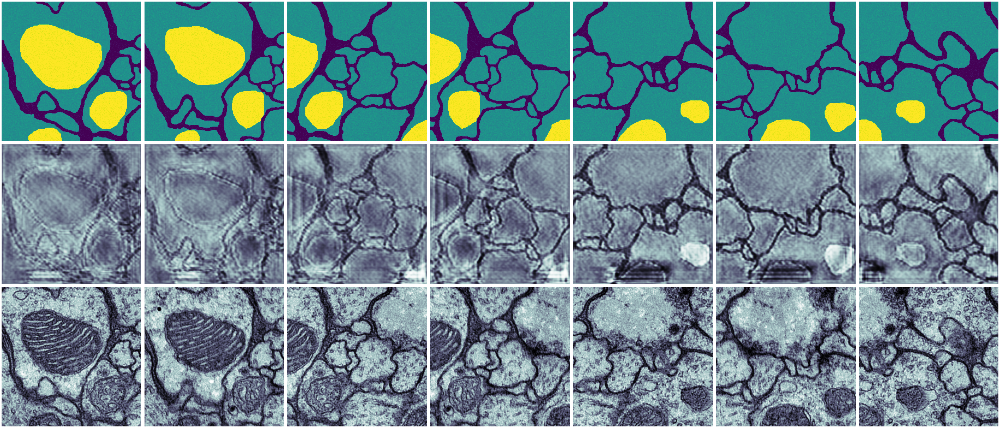

In [16]:
fig, axs = plt.subplots(3, 7, figsize = (80, 35))

for i in range(7):

    label, mask = dataset.update()(validation=True, sigma=0.06)

    prediction = model.predict(np.array([mask]))

    axs[2,i].imshow(label, vmin=-1, vmax=1, cmap="bone")
    axs[2,i].axis("off")

    axs[1,i].imshow(prediction[0, ..., 0], vmin=-1, vmax=1, cmap="bone")
    print(np.ptp(prediction[0, ..., 0]))
    axs[1,i].axis("off") 

    axs[0,i].imshow(mask, vmin = -1, vmax = 1)
    axs[0,i].axis("off")

plt.subplots_adjust(wspace=0.02, hspace=0.02)
plt.show()  

### 6.2 Noise importance visualization

We show an image with increasing amounts of noise in the mask. We update the dataset once to load an image from the validation set. We then resolve that image with increasing sigma.

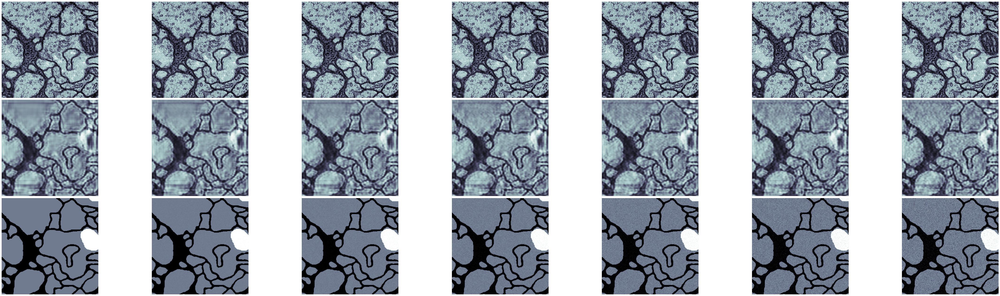

In [17]:
fig, axs = plt.subplots(3, 7, figsize = (80, 23))

# Feel free to change index to show another file!
# dataset.update(index=10, validation=True)

for i in range(7):

    label, mask = dataset.resolve(validation=True, index=10, sigma=0.02 * i)

    prediction = model.predict(np.array([mask]))

    axs[0,i].imshow(label, cmap="bone")
    axs[0,i].axis("off")

    axs[1,i].imshow(prediction[0, ..., 0], vmin=-1, vmax=1, cmap="bone")
    axs[1,i].axis("off")          
    axs[2,i].imshow(mask, vmin=-1, vmax=1, cmap="bone")
    axs[2,i].axis("off")      


plt.subplots_adjust(wspace=0.02, hspace=0.02)
plt.show()  